In [1]:
!git clone https://mszarski:{}@github.com/mszarski/flatmesh

Cloning into 'flatmesh'...
remote: Enumerating objects: 30, done.
remote: Counting objects: 100% (30/30), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 30 (delta 4), reused 23 (delta 3), pack-reused 0
Unpacking objects: 100% (30/30), done.


In [2]:
!apt install libeigen3-dev
!ln -sf /usr/include/eigen3/Eigen /usr/include/Eigen

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Suggested packages:
  libeigen3-doc libmrpt-dev
The following NEW packages will be installed:
  libeigen3-dev
0 upgraded, 1 newly installed, 0 to remove and 13 not upgraded.
Need to get 810 kB of archives.
After this operation, 7,128 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libeigen3-dev all 3.3.4-4 [810 kB]
Fetched 810 kB in 1s (649 kB/s)
Selecting previously unselected package libeigen3-dev.
(Reading database ... 146374 files and directories currently installed.)
Preparing to unpack .../libeigen3-dev_3.3.4-4_all.deb ...
Unpacking libeigen3-dev (3.3.4-4) ...
Setting up libeigen3-dev (3.3.4-4) ...


In [3]:
!pip install ./flatmesh

Processing ./flatmesh
  Created wheel for flatmesh: filename=flatmesh-0.0.1-cp36-cp36m-linux_x86_64.whl size=5763776 sha256=96e2f83d2d3c14e23808375ba398a686d69153be9a81065971163706a41d1517
  Stored in directory: /tmp/pip-ephem-wheel-cache-wpnp1ucr/wheels/e2/ce/d5/e541f72b10062c7b5699690828825b335938ca92f396cb0fff
Successfully built flatmesh


In [ ]:
!pip install trimesh open3d

In [5]:
from google.colab import drive
from os.path import join

ROOT = '/content/drive'     # default for the drive
PROJ = 'My Drive/draping_workspace'       # path to your project on Drive

drive.mount(ROOT)

Mounted at /content/drive


In [6]:
import trimesh
import numpy as np
from scipy.spatial import distance
import flatmesh
import matplotlib.pyplot as plt

In [7]:
curved_mesh = trimesh.load('/content/drive/My Drive/draping_workspace/double_hump_mm.obj',process=False)

In [8]:
curved_mesh.show()

In [16]:
simplified_curved_mesh = curved_mesh.simplify_quadratic_decimation(curved_mesh.faces.shape[0]/4)

In [17]:
simplified_curved_mesh.show()

In [105]:
flat_mesh.export('/content/drive/My Drive/draping_workspace/double_hump_mm_simplified.obj')

'# https://github.com/mikedh/trimesh\nv 77.61628035 26.83814647 0.00000000\nv -40.92866778 -17.78910424 0.00000000\nv 80.04564737 105.66448994 0.00000000\nv -10.26851073 -85.70065047 0.00000000\nv 14.16455355 -74.28405634 0.00000000\nv -40.07108594 89.84458966 0.00000000\nv -80.81265948 60.24695170 0.00000000\nv -46.84606289 -103.34577228 0.00000000\nv -49.23427802 -64.16937657 0.00000000\nv 26.14817400 36.84861414 0.00000000\nv -57.63343330 33.48562933 0.00000000\nv -12.79147434 101.60067002 0.00000000\nv 53.38862295 30.54044043 0.00000000\nv -49.26985480 -81.47444796 0.00000000\nv 33.20729347 65.62407964 0.00000000\nv 45.45978042 49.64456521 0.00000000\nv -43.30512999 45.65982716 0.00000000\nv -30.82409647 -22.54870769 0.00000000\nv -0.10996853 -78.38202828 0.00000000\nv 35.96949070 -52.80415144 0.00000000\nv 5.22234760 8.08663181 0.00000000\nv -32.37384429 100.32872116 0.00000000\nv 10.19870041 -48.51250678 0.00000000\nv -23.57298155 36.34890738 0.00000000\nv -86.47586814 98.6009189

INFO - 2021-02-02 03:24:18,130 - animation - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO - 2021-02-02 03:24:18,137 - animation - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 1080x1080 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpcji1npqu/temp.m4v


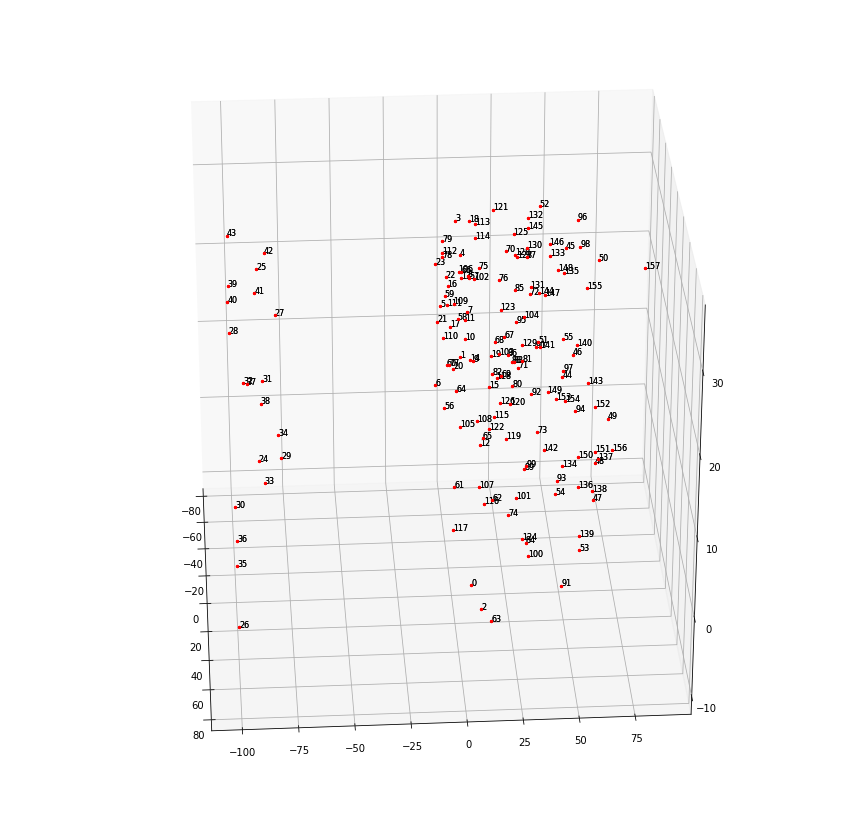

In [22]:
plt.rcParams["figure.figsize"] = (15,15)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

from IPython.display import HTML
import matplotlib.animation as animation

def init():
    for i in range(simplified_curved_mesh.vertices.shape[0]):
      ax.scatter(simplified_curved_mesh.vertices[i,0],curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2],c='red',s=5)
      ax.text(simplified_curved_mesh.vertices[i,0],curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2], str(i),fontsize=8)

    return fig,

def animate(i):
    ax.view_init(elev=30., azim=3.6*i)
    return fig,

# Animate
ani = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=100, blit=True)    

HTML(ani.to_html5_video())

In [93]:
v = simplified_curved_mesh.vertices
f = simplified_curved_mesh.faces

# p0 = 0
# distances = distance.cdist(v, [v[p0]], 'euclidean')
# p1 = distances.argmax()
# dist = distances[p1][0]

p0 = 2
p1 = 153

flattener = flatmesh.FaceUnwrapper(v, f)
flattener.findFlatNodes(5, 0.99)
uv = flattener.ze_nodes

In [94]:
flat_vertices = np.vstack((uv[:,1], uv[:,0], np.zeros_like(uv[:,1]))).T

In [95]:
#align mesh constant seam in xy plane
v_flat = flat_vertices[p1] - flat_vertices[p0]
v_curved = v[p1] - v[p0]
v_curved[2] = 0.0
T, a = trimesh.geometry.align_vectors(v_curved, v_flat, return_angle=True)
flat_vertices = trimesh.transformations.transform_points(flat_vertices,T)

In [96]:
flat_mesh = trimesh.Trimesh(vertices=flat_vertices,
                       faces=simplified_curved_mesh.faces,
                       process=False)

In [97]:
com_delta = simplified_curved_mesh.centroid - flat_mesh.centroid
com_delta[2] = 0
flat_mesh.vertices = flat_mesh.vertices + com_delta

In [101]:
flat_mesh.show()

In [102]:
trimesh.repair.fix_normals(flat_mesh)

In [103]:
flat_mesh.vertices = flat_mesh.vertices * 0.99

In [104]:
scene = trimesh.Scene([simplified_curved_mesh, flat_mesh])
scene.show(viewer='notebook')

In [106]:
flat_mesh.export('/content/drive/My Drive/draping_workspace/double_hump_mm_flatmesh_simplified_99pc.obj')

'# https://github.com/mikedh/trimesh\nv 77.61628035 26.83814647 0.00000000\nv -40.92866778 -17.78910424 0.00000000\nv 80.04564737 105.66448994 0.00000000\nv -10.26851073 -85.70065047 0.00000000\nv 14.16455355 -74.28405634 0.00000000\nv -40.07108594 89.84458966 0.00000000\nv -80.81265948 60.24695170 0.00000000\nv -46.84606289 -103.34577228 0.00000000\nv -49.23427802 -64.16937657 0.00000000\nv 26.14817400 36.84861414 0.00000000\nv -57.63343330 33.48562933 0.00000000\nv -12.79147434 101.60067002 0.00000000\nv 53.38862295 30.54044043 0.00000000\nv -49.26985480 -81.47444796 0.00000000\nv 33.20729347 65.62407964 0.00000000\nv 45.45978042 49.64456521 0.00000000\nv -43.30512999 45.65982716 0.00000000\nv -30.82409647 -22.54870769 0.00000000\nv -0.10996853 -78.38202828 0.00000000\nv 35.96949070 -52.80415144 0.00000000\nv 5.22234760 8.08663181 0.00000000\nv -32.37384429 100.32872116 0.00000000\nv 10.19870041 -48.51250678 0.00000000\nv -23.57298155 36.34890738 0.00000000\nv -86.47586814 98.6009189

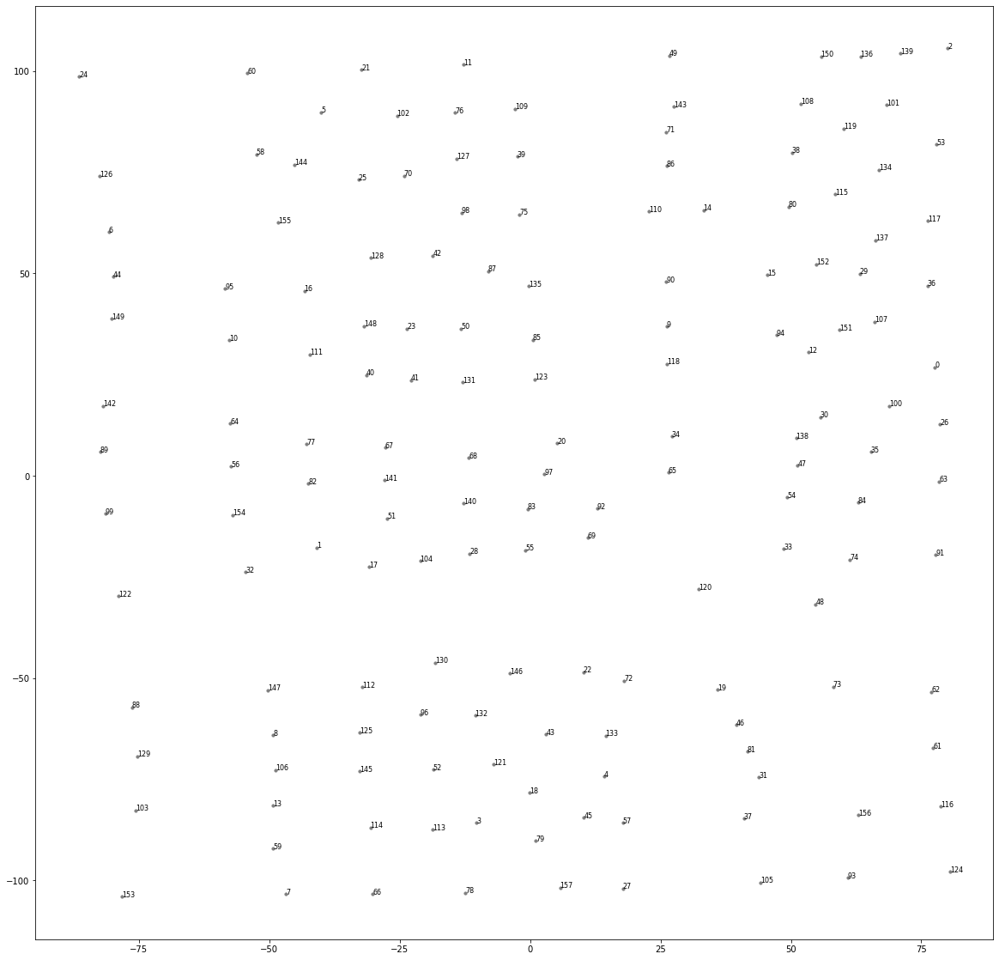

In [107]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,20)
plt.scatter(flat_mesh.vertices[:,0],flat_mesh.vertices[:,1],c='grey',s=10)
for i in range(flat_mesh.vertices.shape[0]):
    plt.text(flat_mesh.vertices[i,0], flat_mesh.vertices[i,1], str(i),fontsize=8)

In [108]:
from trimesh import grouping
# we know that in a watertight mesh every edge will be included twice
# thus every edge which appears only once is part of a boundary
boundary_groups = grouping.group_rows(
    flat_mesh.edges_sorted, require_count=1)

boundary_edges = flat_mesh.edges[boundary_groups]
index_as_dict = [{'index': i} for i in boundary_groups]

import networkx as nx

# we create a graph of the boundary edges, and find cycles.
g = nx.from_edgelist(
    np.column_stack((boundary_edges,
                     index_as_dict)))
idxs = []
for vertex in nx.cycle_basis(g):
    idxs.append(vertex)


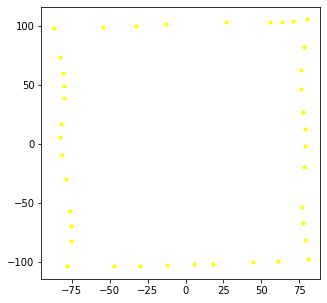

In [109]:
plt.rcParams["figure.figsize"] = (5,5)
plt.scatter(flat_mesh.vertices[idxs,0],flat_mesh.vertices[idxs,1],c='yellow',s=10)

In [110]:
np.array(idxs)

array([[ 26,  63,  91,  62,  61, 116, 124,  93, 105,  27, 157,  78,  66,
          7, 153, 103, 129,  88, 122,  99,  89, 142, 149,  44,   6, 126,
         24,  60,  21,  11,  49, 150, 136, 139,   2,  53, 117,  36,   0]])

INFO - 2021-02-02 03:49:15,273 - animation - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO - 2021-02-02 03:49:15,276 - animation - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 1080x1080 -pix_fmt rgba -r 10.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpybjtvdi5/temp.m4v


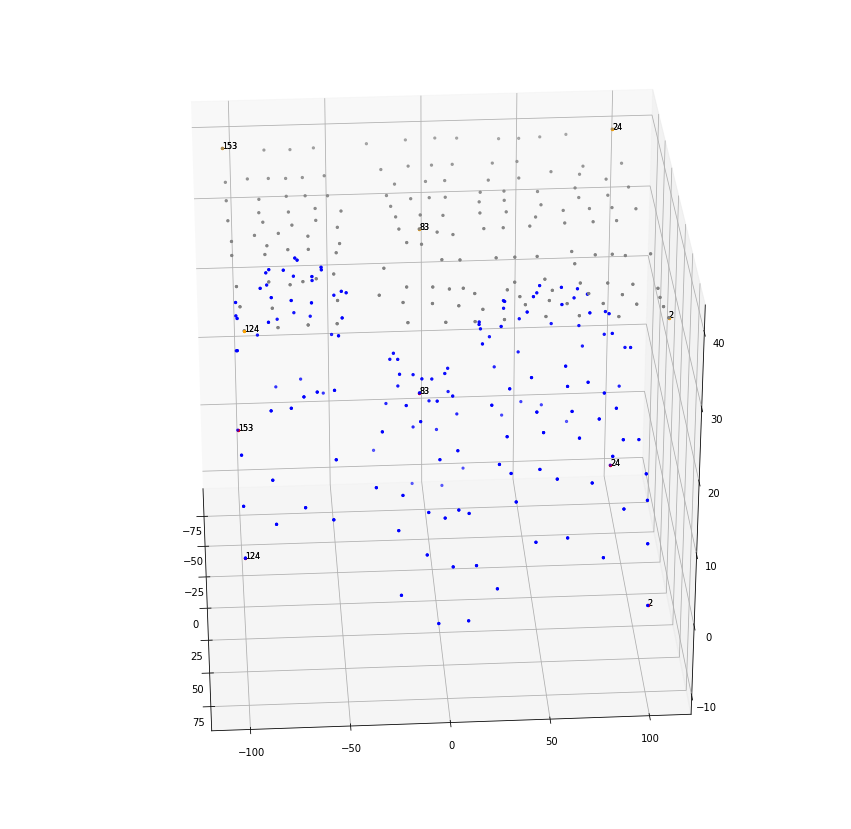

In [113]:
handles = [24, 2, 153, 124]
other_pts = [83]

plt.rcParams["figure.figsize"] = (15,15)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

from IPython.display import HTML
import matplotlib.animation as animation

def init():
    ax.scatter(flat_mesh.vertices[:,0],flat_mesh.vertices[:,1],flat_mesh.vertices[:,2]+40,c='grey',s=5)
    ax.scatter(simplified_curved_mesh.vertices[:,0],simplified_curved_mesh.vertices[:,1],simplified_curved_mesh.vertices[:,2],c='blue',s=5)
    for i in [*handles]:
        ax.scatter(flat_mesh.vertices[i,0],flat_mesh.vertices[i,1],flat_mesh.vertices[i,2]+40,c='orange',s=5)
        ax.text(flat_mesh.vertices[i,0], flat_mesh.vertices[i,1],flat_mesh.vertices[i,2]+40, str(i),fontsize=8)
        ax.scatter(simplified_curved_mesh.vertices[i,0],simplified_curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2],c='red',s=5)
        ax.text(simplified_curved_mesh.vertices[i,0],simplified_curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2], str(i),fontsize=8)

    for i in [*other_pts]:
        ax.scatter(flat_mesh.vertices[i,0],flat_mesh.vertices[i,1],flat_mesh.vertices[i,2]+40,c='orange',s=5)
        ax.text(flat_mesh.vertices[i,0], flat_mesh.vertices[i,1],flat_mesh.vertices[i,2]+40, str(i),fontsize=8)
        ax.scatter(simplified_curved_mesh.vertices[i,0],simplified_curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2],c='red',s=5)
        ax.text(simplified_curved_mesh.vertices[i,0],simplified_curved_mesh.vertices[i,1],simplified_curved_mesh.vertices[i,2], str(i),fontsize=8)

    return fig,

def animate(i):
    ax.view_init(elev=30., azim=3.6*i)
    return fig,

# Animate
ani = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=100, blit=True)    

HTML(ani.to_html5_video())

In [ ]:
from matplotlib import rc

rc('animation', html='jshtml')
ani

Animation size has reached 20971524 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
